#### This notebook uses *datenguidepy* to collect regional statistics from the German Federal Statistical Office. For illustration the data are displayed on a map using *geoviews*. 

You can compare the result to [Regionalatlas Statistisches Bundesamt](https://www-genesis.destatis.de/gis/genView?GenMLURL=https://www-genesis.destatis.de/regatlas/AI002-1.xml&CONTEXT=REGATLAS01).

Steps:

- Load package *datenguidepy*

- Get region code on nuts3 level with "get_all_regions().query('level == nuts3')"

- Search for statistics codes with "get_statistics().query('XXX')"

- Define a year filter with "add_args({'year' : [2015]})"

- Define Query using statistics codes, region code and add a filter

- Collect data

- Plot the data on a map, e.g. with *geoviews*. (Note that you need to add data on the shape of the regions first.)

In [1]:
import os
if not os.path.basename(os.getcwd()) == "datenguide-python":
    os.chdir("..")

from datenguidepy import Query

from datenguidepy.query_helper import get_regions, get_statistics

In [2]:
reg = get_regions()

relevant_region_subset = reg.query('level == "nuts3"').index

In [3]:
def get_data(regcode, stat):
    query = Query.region(regcode)
    field = query.add_field(stat)
    field.add_args({'year': [2015]})
    df = query.results()
    return df

In [4]:
print(get_statistics().query('short_description.str.contains("Geburten-/Gestorbenenüberschuss je 10.000")', engine='python'))

print(' ------------- ')

print(get_statistics().query('short_description.str.contains("Lebendgeborene je 10.000 Einwohner")', engine='python'))

                                         short_description  \
statistic                                                    
AI0211     Geburten-/Gestorbenenüberschuss je 10.000 Einw.   

                                            long_description  
statistic                                                     
AI0211     wiki\n==Geburtenüberschuss (+) bzw. Gestorbene...  
 ------------- 
                            short_description  \
statistic                                       
AI0209     Lebendgeborene je 10.000 Einwohner   

                                            long_description  
statistic                                                     
AI0209     wiki\n==Lebendgeborene je 10.000 Einwohner==\n...  


In [5]:
import pandas as pd

dataout = pd.DataFrame()

statlist = ['AI0211', 'AI0209']

for stat in statlist:
    data = pd.DataFrame()
    for regcode in relevant_region_subset:
        df = get_data(str(regcode), stat)
        if df.empty:
            print("no data for region code " + regcode + " and statistic " + stat)
            pass
        else:
            data = data.append(df).copy()
    if dataout.empty:
        dataout = data.copy()
    else:
        dataout = dataout.merge(data, on = ['id', 'name', 'year']).copy()
        
dataout.head()

,id,name,year,AI0211,AI0211_source_title_de,AI0211_source_valid_from,AI0211_source_periodicity,AI0211_source_name,AI0211_source_url,AI0209,AI0209_source_title_de,AI0209_source_valid_from,AI0209_source_periodicity,AI0209_source_name,AI0209_source_url
0,10041,"Saarbrücken, Regionalverband",2015,-56.1,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None,81.1,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None
1,10042,"Merzig-Wadern, Landkreis",2015,-64.6,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None,69.2,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None
2,10043,"Neunkirchen, Landkreis",2015,-73.3,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None,70.3,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None
3,10044,"Saarlouis, Landkreis",2015,-54.2,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None,77.8,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None
4,10045,Saarpfalz-Kreis,2015,-55.5,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None,76.8,Regionalatlas Deutschland,1995-01-01T00:00:00,JAEHRLICH,99910,None


Add information on the shape of the regions ([downloaded from](https://gdz.bkg.bund.de/index.php/default/digitale-geodaten/verwaltungsgebiete/verwaltungsgebiete-1-250-000-ebenen-stand-01-01-vg250-ebenen-01-01.html)):



In [6]:
import geopandas as gpd

de = gpd.read_file(YOUR_PATH + '/vg250_2019-01-01.gk3.shape.ebenen/vg250_ebenen/VG250_KRS.shp')

de['AGS'].sort_values()

de=de.to_crs({'init': 'epsg:4326'})

dataout['AGS'] = dataout['id']

df = gpd.GeoDataFrame(de.merge(dataout, on = 'AGS')).drop_duplicates(subset=['id', 'year'])[['geometry',  'name', 'year',  'AI0211', 'AI0209']]

/home/konrad/programming/python/correlaid/datenguide-python/venv/lib/python3.7/site-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
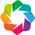

In [15]:
import geoviews as gv

gv.extension('bokeh','matplotlib')

In [16]:
df_plt = df[(df['year']==2015) & (df['AI0211']!=0)][['geometry', 'name', 'AI0211']].dropna()

gv.Polygons(df_plt, vdims=['name', 'AI0211'], label="Geburten-/Gestorbenenüberschuss je 10.000 (2015)").opts(
    tools=['hover'], width=550, height=700, color_index='AI0211',
    colorbar=True, cmap='coolwarm', toolbar='left')

:Polygons   [Longitude,Latitude]   (name,AI0211)

In [9]:
df_plt = df[(df['year']==2015) & (df['AI0209']!=0)][['geometry', 'name', 'AI0209']].dropna()

gv.Polygons(df_plt, vdims=['name', 'AI0209'], label="Lebendgeborene je 10.000 Einwohner (2015)").opts(
    tools=['hover'], width=550, height=700, color_index='AI0209',
    colorbar=True, cmap='coolwarm', toolbar='left')

:Polygons   [Longitude,Latitude]   (name,AI0209)